In [1]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt

In [2]:
def compress_xy(x,y,CONST):
    return y * CONST + x

In [3]:
def extract_xy(compress,CONST):
    return [compress % CONST, int(compress / CONST)]

In [4]:
def find_skeleton_centers(cell_count, gradient_total, threshold, regs_label):
    centers = []
    for i in range(cell_count+1):
        masked = (regs_label == i) & (gradient_total < threshold)
        if not np.any(masked):
            continue
        #Skeleton of this cell
        y = np.ma.array(gradient_total * masked)
        row_indices, col_indices = np.where(y < 0)
        if(len(row_indices)<1):
            original_field = (regs_label == i)
            row_indices, col_indices = np.ma.where(original_field)
        #Find the geomerty center
        x_center = np.mean(row_indices)
        y_center = np.mean(col_indices)
        #Projected the geomerty center on skeleton
        distances = np.sqrt((row_indices - x_center)**2 + (col_indices - y_center)**2)
        closest_index = np.argmin(distances)
        closest_point = (row_indices[closest_index], col_indices[closest_index])
        #Found skeleton center
        centers.append(compress_xy(closest_point[1], closest_point[0], DIGIT))
        
    return centers

In [5]:
def flow_to_ends(start_points, gradient_total,threshold):
    #Don't pollute original data
    start_points_copy = start_points.copy()
    gradient_total_copy = gradient_total.copy()
    masked_array = gradient_total_copy < threshold
    #Point set is the set flow go through 
    point_set = set(start_points_copy)
    end_point = []
    while point_set:
        newset = set()
        for element in point_set:
            [xx,yy] = extract_xy(element,DIGIT)
            #DO waterfront
            waterfront_set = set([element -1 , element +1, element - DIGIT +1, element + DIGIT +1, element + DIGIT -1, element - DIGIT -1, element + DIGIT, element - DIGIT])
            flag = False
            for each in waterfront_set:
                [x,y] = extract_xy(each,DIGIT)
                if ((x < 0) or (y < 0) or (y >= len(masked_array)) or (x >= len(masked_array[0]))):
                    continue
                else:
                    if (masked_array[y,x] == True ):
                        newset.add(each)
                        flag = True
            if flag == False:
                end_point.append(element)
            masked_array[yy,xx] = False

        #Mask the pixels out when the whole waterfront of pixels iterated, so won't self eated. 
        for each in newset:
            [x,y] = extract_xy(each,DIGIT)
            masked_array[y,x] = False
            
        point_set = newset

    return end_point

In [6]:
def get_masked_skeleton(cell_number, gradient_total, regs_label, threshold):
    masked = (gradient_total < threshold)
    if(cell_number != -1): 
        masked = masked & (regs_label == cell_number)
    masked_skeleton = np.ma.array(gradient_total * masked)
    return masked_skeleton

In [7]:
def find_muti_ends(ends_count, cell_count, centers, gradient_total,threshold, regs_label):
    all_ends = []
    for time in range(ends_count):
        current_start = centers if time == 0 else all_ends
        result_ends = flow_to_ends(current_start, gradient_total,threshold)
        for i in range(1,cell_count+1):
            mask =  (gradient_total < threshold) & (regs_label == i)
            current_result = -1
            for element in result_ends:
                [x,y] = extract_xy(element,DIGIT)
                if(mask[y,x] == True):
                    current_result = element
            if(current_result != -1): 
                all_ends.append(current_result)
    return all_ends

In [8]:
def calculate_local_slop(point, radius,gradient_total,regs_label, threshold):
    [x,y] = extract_xy(point,DIGIT)
    #+1 here is only for boundary condition
    x_array = []
    y_array = []
    # get the masks 
    cell_number = regs_label[y,x]
    mask = (gradient_total < threshold) & (regs_label == cell_number)
    for xi in range(max(x-radius,0), min(x+radius+1,len(gradient_total[0]))):
        for yi in range(max(y-radius,0),min(y+radius+1,len(gradient_total))):
            if (np.sqrt((xi-x)**2 + (yi-y)**2) <= radius) and (mask[yi,xi]):
                x_array.append(xi)
                y_array.append(yi)
    return [x - np.mean(x_array), y - np.mean(y_array)]

In [11]:
#Skeleton field
dat = np.load('211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00001xy0c1_seg.npy', allow_pickle=True).item()
gradientsx = np.gradient(dat['flows'][-1][0])
gradientsy = np.gradient(dat['flows'][-1][1])
gradient_total = gradientsy[1] + gradientsx[0]

#Cell masks field
mat = scipy.io.loadmat('regs_label.mat')
regs_label = mat['regs'][0][0][0]

#Const digit
DIGIT = 100000
CONST = 100000

In [9]:
def work(npy_path):
    dat = np.load(npy_path, allow_pickle=True).item()
    gradientsx = np.gradient(dat['flows'][-1][0])
    gradientsy = np.gradient(dat['flows'][-1][1])
    gradient_total = gradientsy[1] + gradientsx[0]
    regs_label = dat['masks']
    cell_num = np.max(regs_label)
    centers = find_skeleton_centers(cell_num, gradient_total, -3, regs_label)
    all_ends = find_muti_ends(2, cell_num, centers, gradient_total,-3, regs_label)
    trans_array = np.zeros([len(regs_label[0]),len(regs_label),3])
    for each in all_ends:
        [x,y] = extract_xy(each,DIGIT)
        [vx,vy] = calculate_local_slop(each, 10,gradient_total,regs_label, -3)
        trans_array[x,y] = [vx,vy,1]
    data = {'vector': trans_array, 'skeleton':gradient_total}
    mat_filename = npy_path.replace('_seg.npy', '_track.mat')
    savemat(mat_filename, data)  

In [12]:
DIGIT = 100000
CONST = 100000

In [ ]:
def store_imag(npy_path):
    image = plt.imshow(gradient_total, cmap='Greys')
    
    plt.xlim(0,2560)
    plt.ylim(0,2160)
    
    plt.gca().invert_yaxis()
    
    for each in all_ends:
        [x,y] = extract_xy(each,DIGIT)
        plt.scatter(x, y, c='red', marker='o')
        [vx,vy] = calculate_local_slop(each, 30,gradient_total,regs_label, -1)
        plt.arrow(x, y, vx*2, vy*2, head_width = 5, width = 0.5, ec ='black')
    image_filename = npy_path.replace('_seg.npy', '.png')
    image_filename = image_filename.replace('xy0/phase', 'images')
    plt.savefig(image_filename)

In [13]:
from scipy.io import savemat
import numpy as np
import glob
import os
npzFiles = glob.glob("/Users/sherryyang/wigginsLab/data/half_raw/xy0/phase/*.npy")
for f in npzFiles:
    work(f)

/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00011xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00016xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00003xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00004xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00032xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00020xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00027xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00005xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_

/var/folders/wp/13gpg6394h94dzpntygyldd00000gn/T/ipykernel_42017/921017746.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(25.63, 21.87))


/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00012xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00015xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00023xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00024xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00031xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00036xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00014xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00013xy0c1_seg.npy
/Users/sherryyang/wigginsLab/data/0814/xy0/phase/211121_

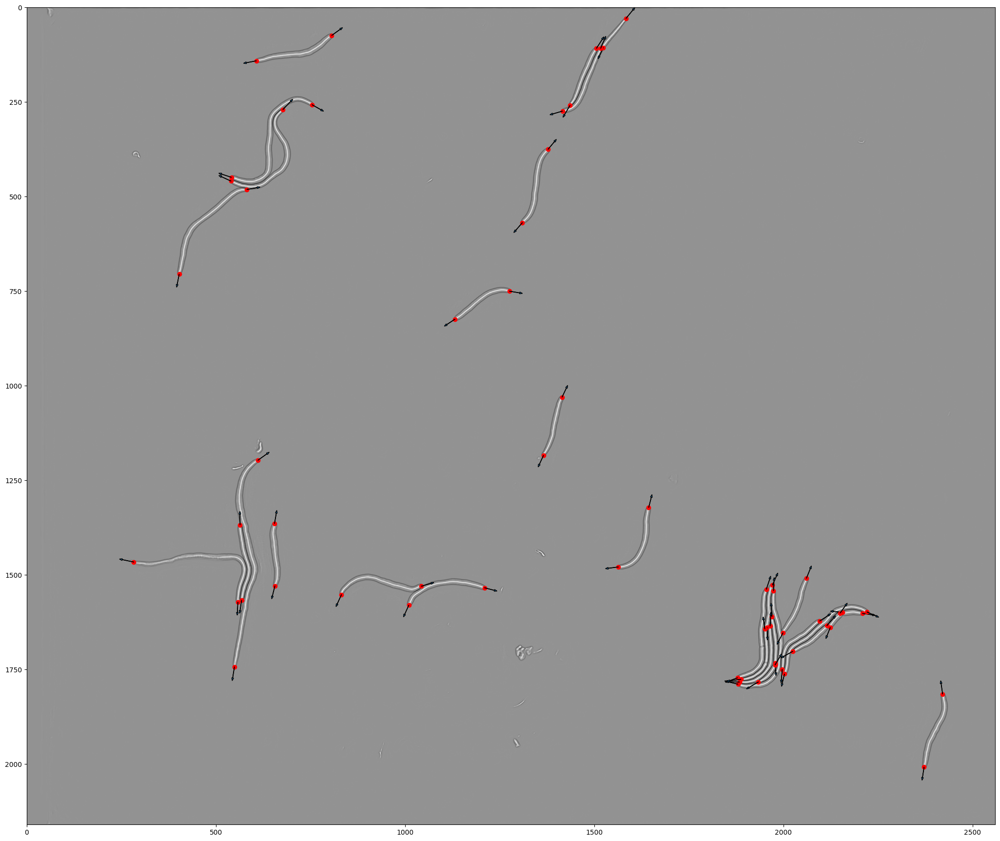

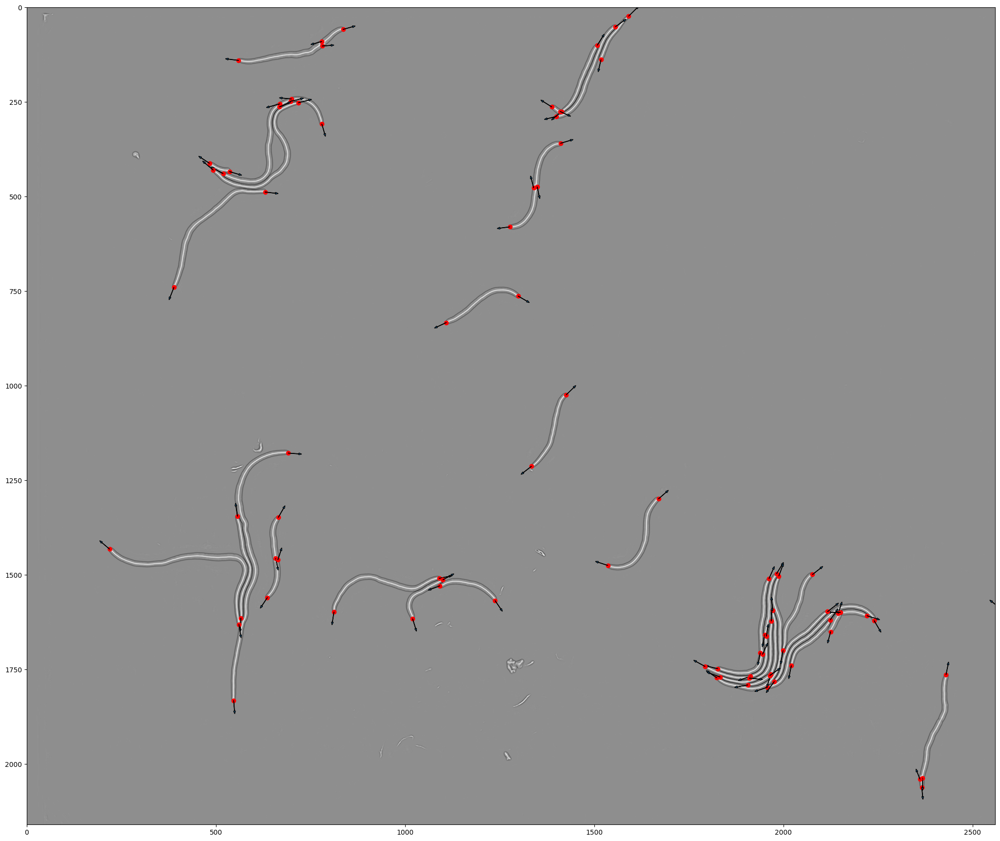

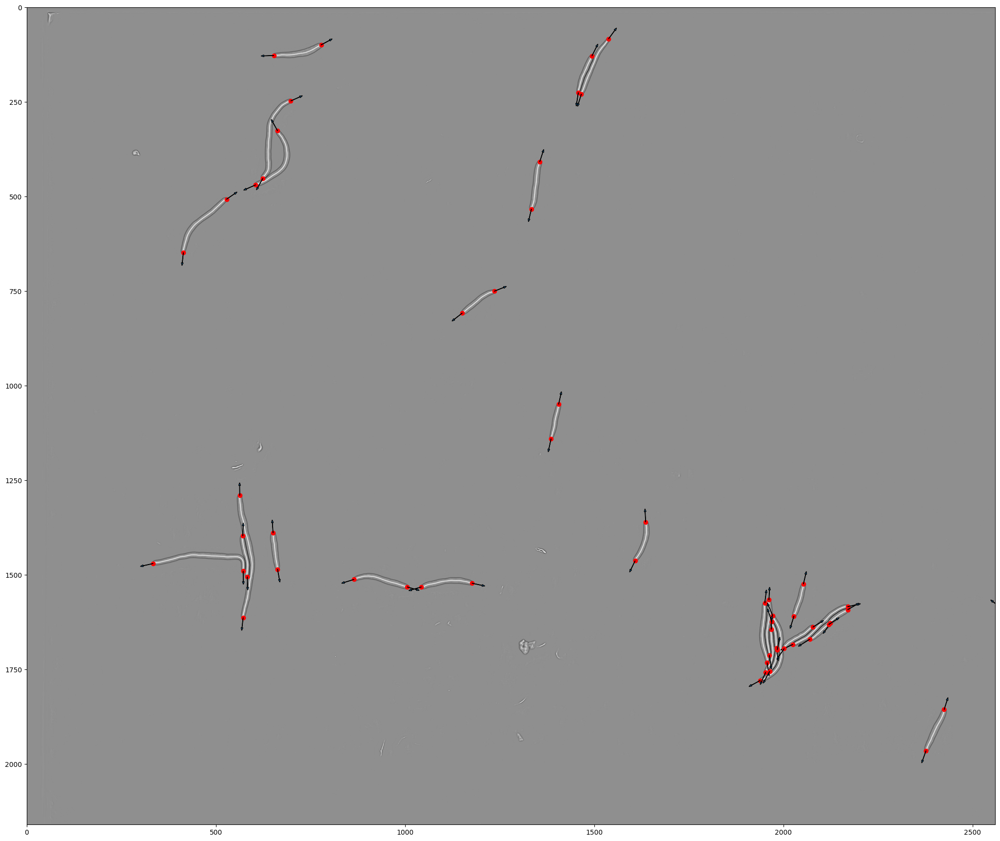

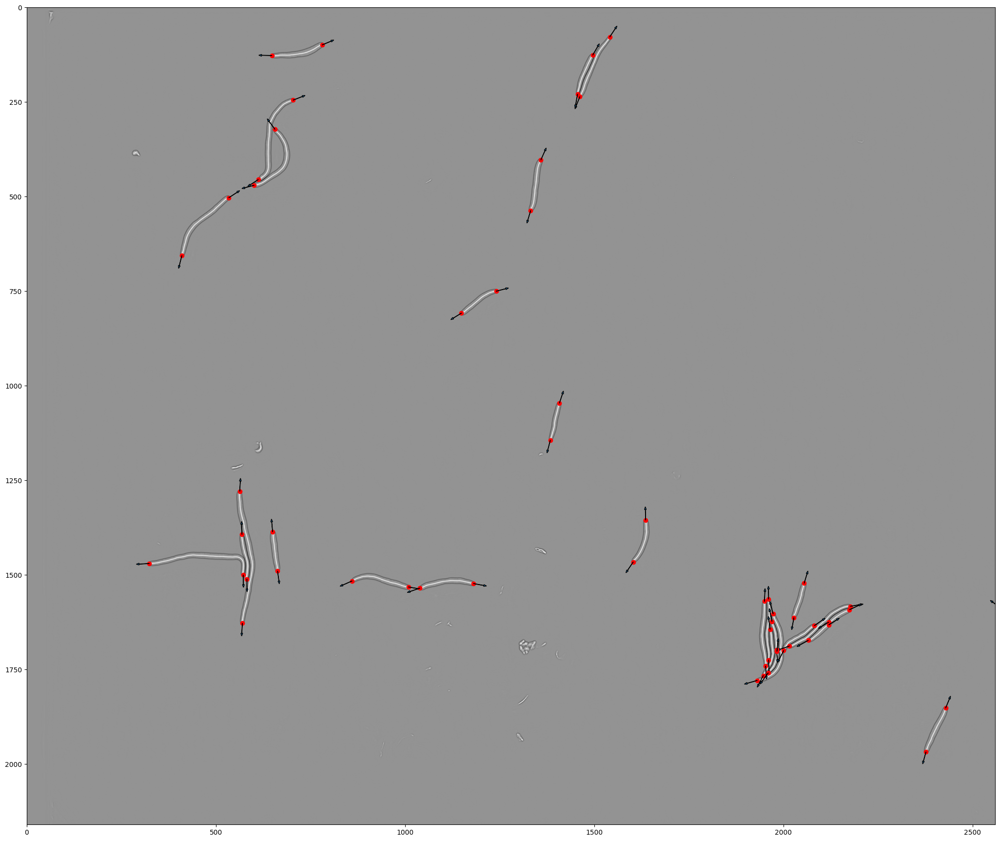

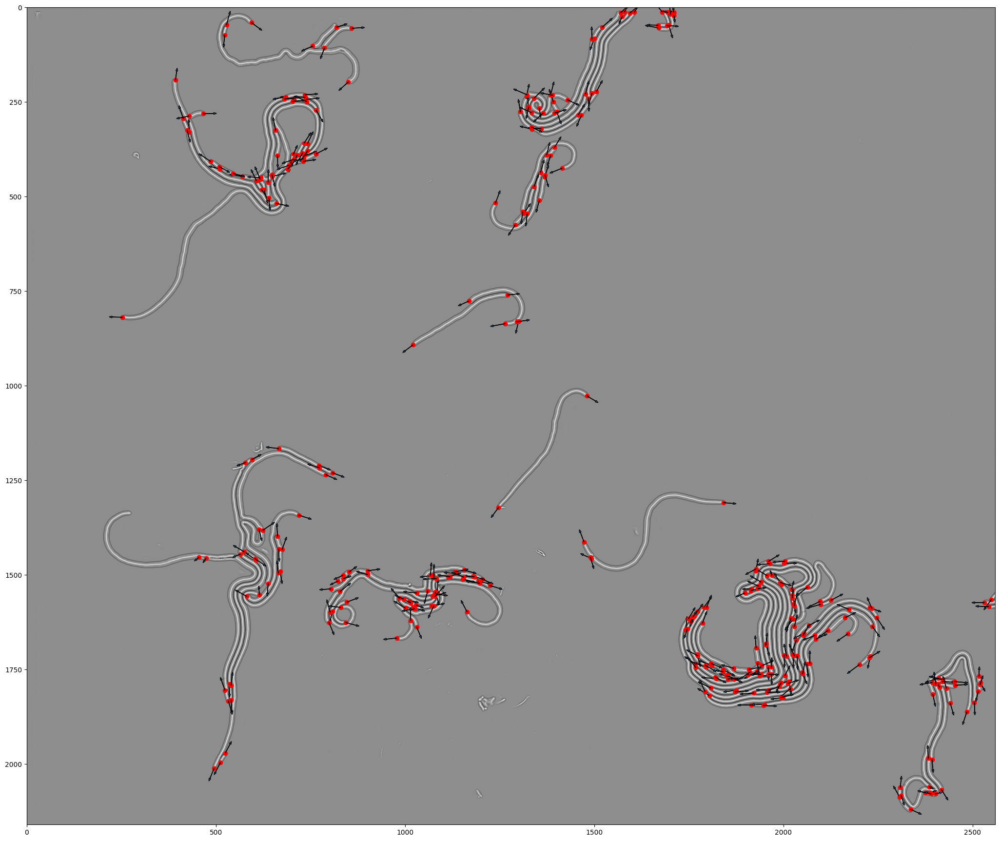

...

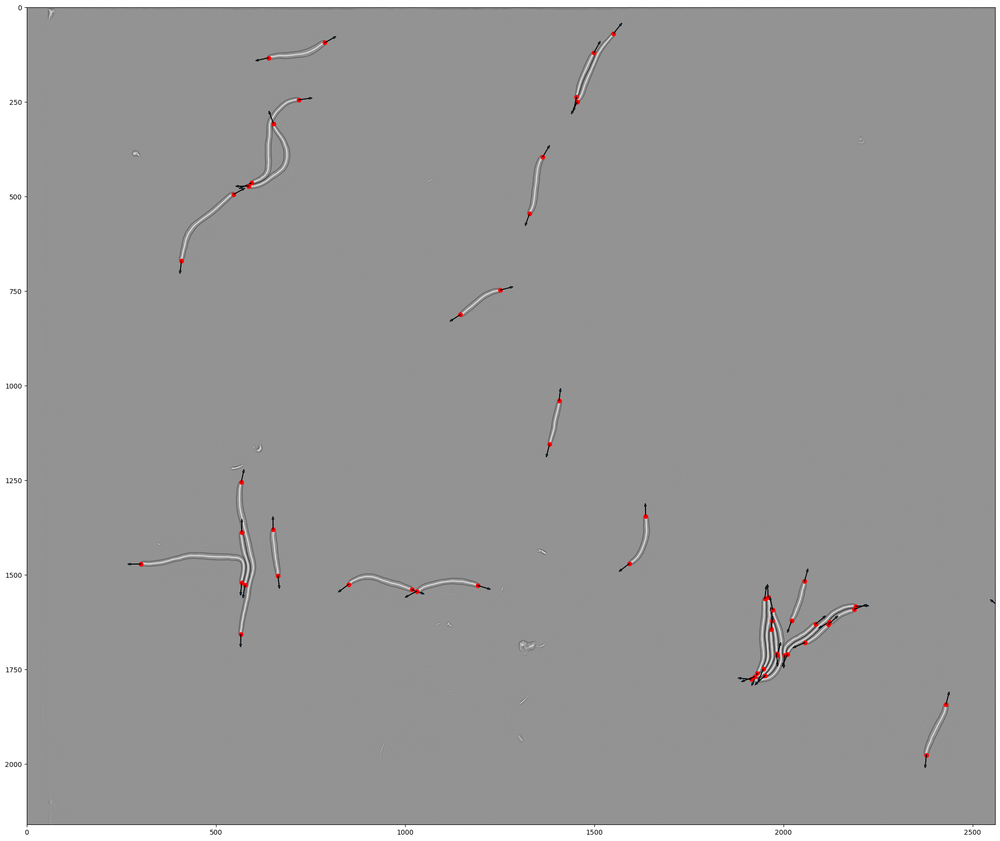

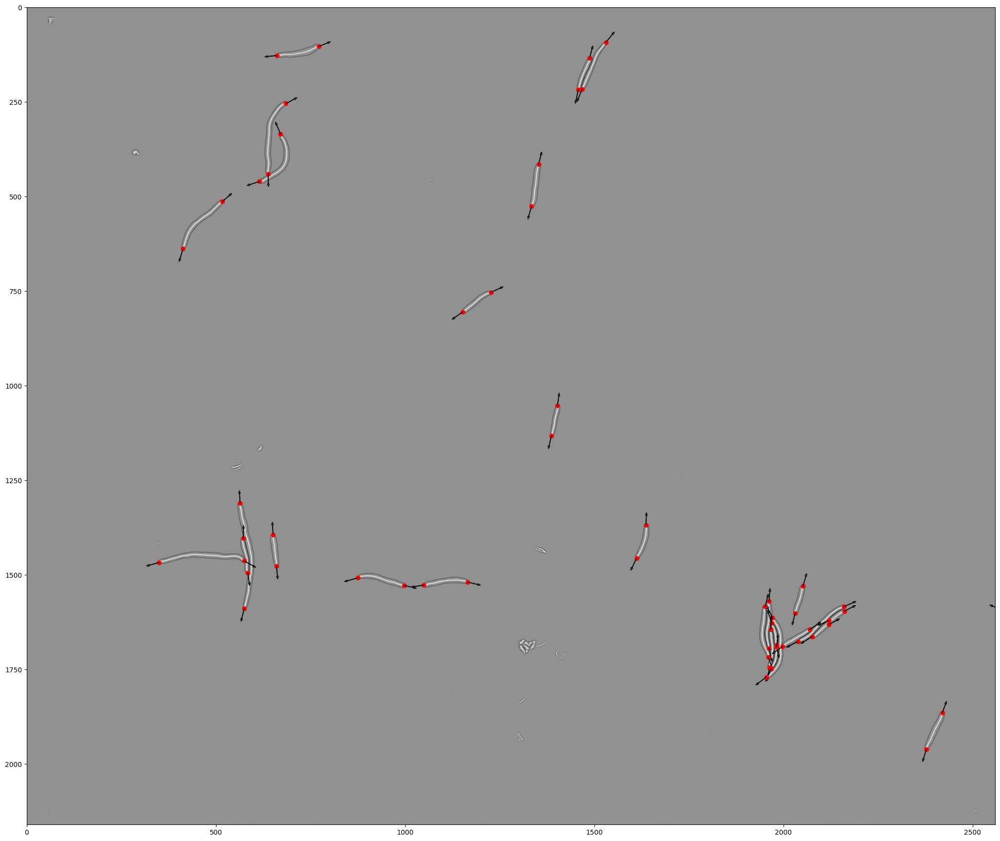

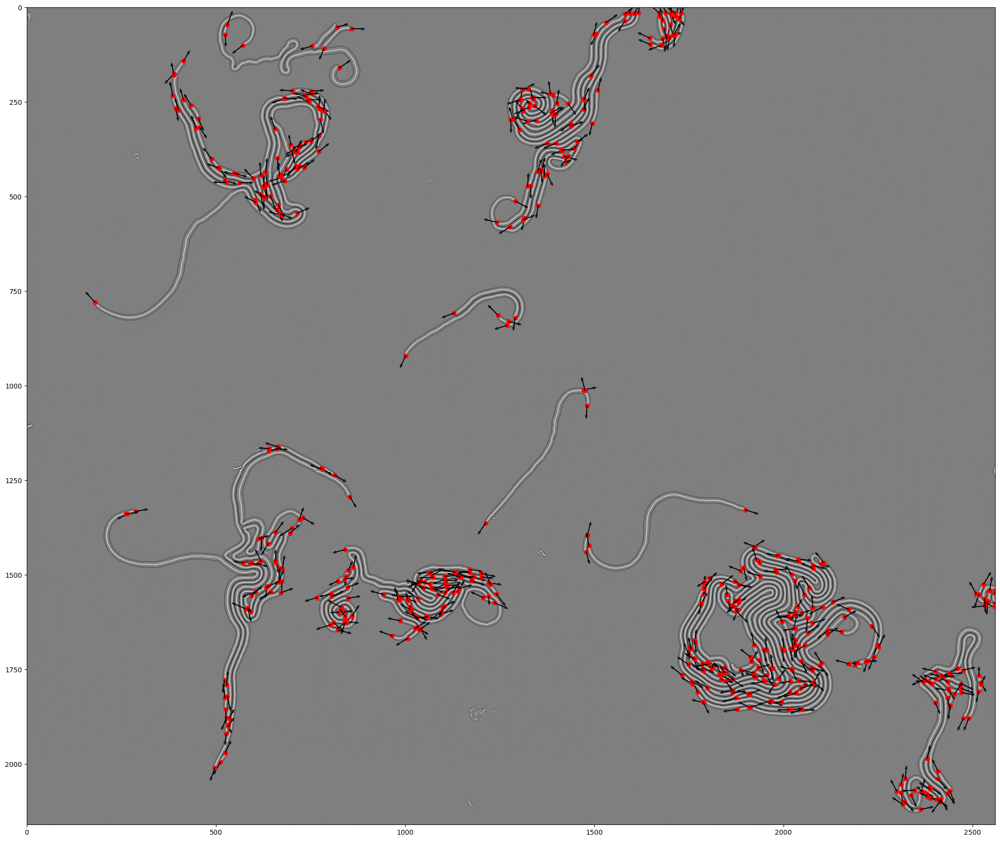

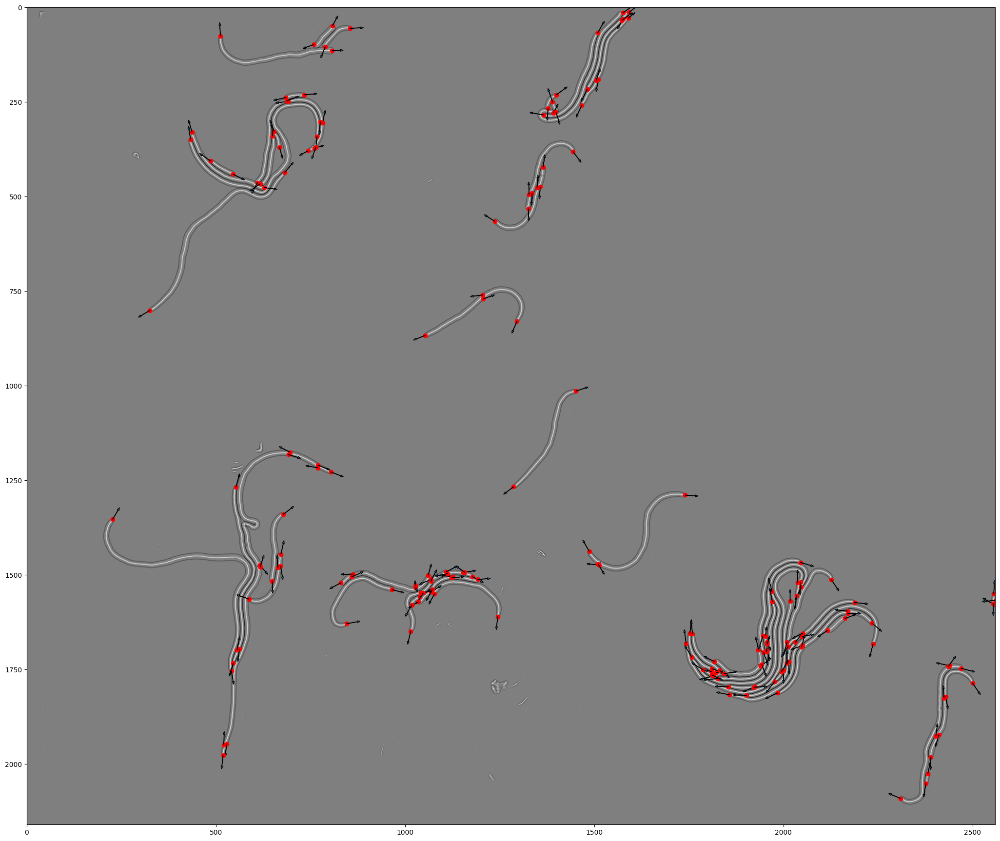

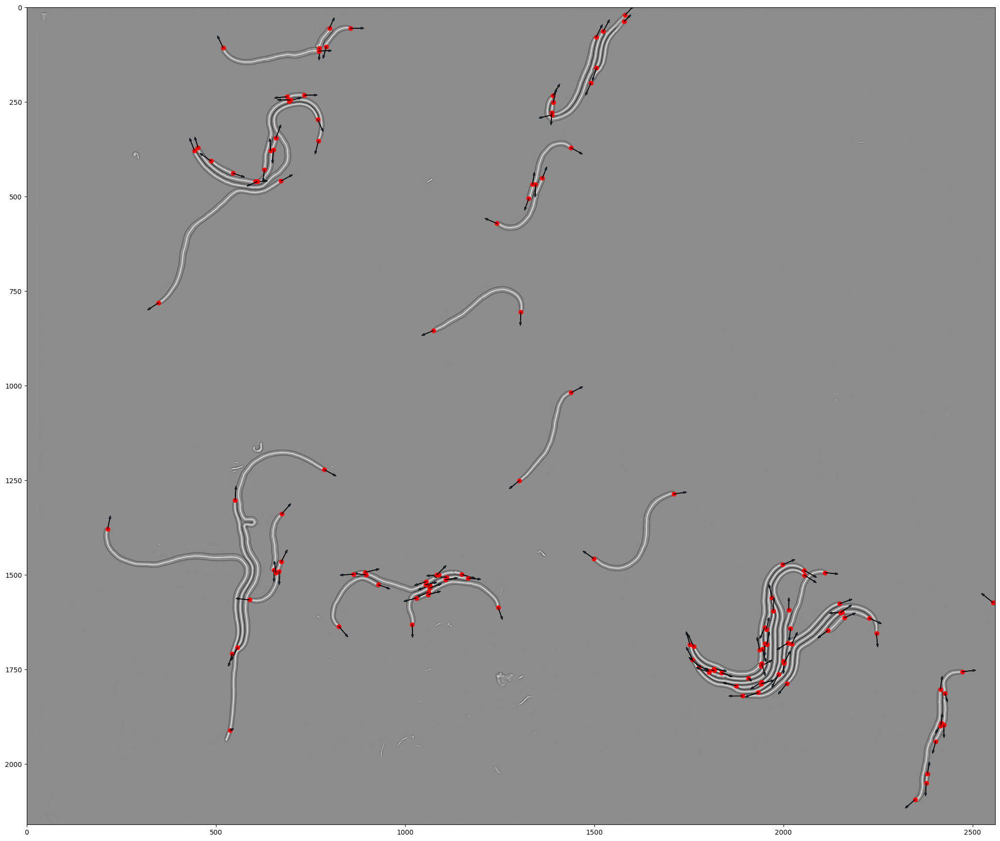

In [39]:
npzFiles = glob.glob("/Users/sherryyang/wigginsLab/data/0814/xy0/phase/*.npy")
for f in npzFiles:
    print(f)
    store_imag(f)

In [41]:
import os
import cv2

# Path to the folder containing your images
image_folder = '/Users/sherryyang/wigginsLab/data/0814/images'

# Get a list of image filenames sorted alphabetically
image_filenames = sorted(os.listdir(image_folder))

# Get the dimensions of the first image (assuming all images have the same dimensions)
first_image = cv2.imread(os.path.join(image_folder, image_filenames[0]))
height, width, layers = first_image.shape

# Define the codec and create a VideoWriter object
video_filename = 'output_video.mp4'
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # You can change the codec as needed
video = cv2.VideoWriter(video_filename, fourcc, 10, (width, height))

# Loop through the sorted image filenames and add frames to the video
for image_filename in image_filenames:
    image_path = os.path.join(image_folder, image_filename)
    frame = cv2.imread(image_path)
    video.write(frame)

# Release the VideoWriter and close the video file
video.release()

print(f"Video '{video_filename}' created successfully.")

Video 'output_video.mp4' created successfully.


In [36]:
!pip install Pillow

In [37]:
import cv2
import glob
import os
from PIL import Image

image_folder = "/Users/sherryyang/wigginsLab/data/manually_fixed/"
image_filenames = sorted(glob.glob(os.path.join(image_folder, "*.tif")))

output_video = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
frame_size = (width, height)  # Replace with actual dimensions
fps = 24

out = cv2.VideoWriter(output_video, fourcc, fps, frame_size)

for image_filename in image_filenames:
    # Open image using PIL
    pil_image = Image.open(image_filename)
    
    # Convert image to RGB if it's not
    if pil_image.mode != 'RGB':
        pil_image = pil_image.convert('RGB')
    
    # Convert PIL image to NumPy array
    img = cv2.cvtColor(np.array(pil_image), cv2.COLOR_RGB2BGR)
    out.write(img)

out.release()


In [30]:
os.path.join(image_folder, image_filenames[1])

'/Users/sherryyang/wigginsLab/data/manually_fixed/t00001.tif'

In [20]:
from PIL import Image
import os

# Path to the folder containing your images
image_folder = '/Users/sherryyang/wigginsLab/data/0814/images'

# Get a list of image filenames sorted alphabetically
image_filenames = sorted(os.listdir(image_folder))

# Open the first image to get the size
base_image = Image.open(os.path.join(image_folder, image_filenames[0]))
width, height = base_image.size

# Create a new image with RGBA mode (allows transparency)
merged_image = Image.new('RGBA', (width, height), (0, 0, 0, 0))

# Loop through the sorted image filenames and paste each image on top of the merged image
for image_filename in image_filenames:
    image_path = os.path.join(image_folder, image_filename)
    image = Image.open(image_path)
    merged_image = Image.alpha_composite(merged_image, image)

# Save the final overlapped image
merged_image.save('merged_image.png')

print("Merged image created successfully.")

FileNotFoundError: [Errno 2] No such file or directory: '/Users/sherryyang/wigginsLab/data/0814/images'

In [38]:
import os
import cv2
import numpy as np

# Path to the folder containing your images
image_folder = '/Users/sherryyang/wigginsLab/data/0722/images'

# Get a list of image filenames sorted alphabetically
image_filenames = sorted(os.listdir(image_folder))

# Read the first image to get its dimensions
base_image = cv2.imread(os.path.join(image_folder, image_filenames[0]), cv2.IMREAD_UNCHANGED)
height, width, channels = base_image.shape

# Create an empty numpy array to store the accumulated result
result = np.zeros((height, width, channels), dtype=np.uint16)

# Loop through the sorted image filenames and accumulate the images
for image_filename in image_filenames:
    image_path = os.path.join(image_folder, image_filename)
    image = cv2.imread(image_path, cv2.IMREAD_UNCHANGED)
    result = image + result



In [ ]:
result = result/np.max(result) * 255
plt.imshow(result, cmap='Greys')

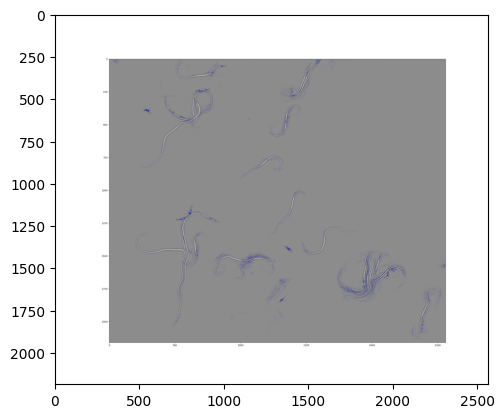

In [54]:
plt.imshow((1.000 * result)/float(np.max(result)))

In [37]:
result

array([[[255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        ...,
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.]],

       [[255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        ...,
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.]],

       [[255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        ...,
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.]],

       ...,

       [[255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        ...,
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.]],

       [[255., 255., 255., 255.],
        [255., 255., 255., 255.],
        [255., 255., 255., 255.],
        .

FileNotFoundError: [Errno 2] No such file or directory: '/Users/sherryyang/wigginsLab/data/0709/images/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00001xy0c1.png'

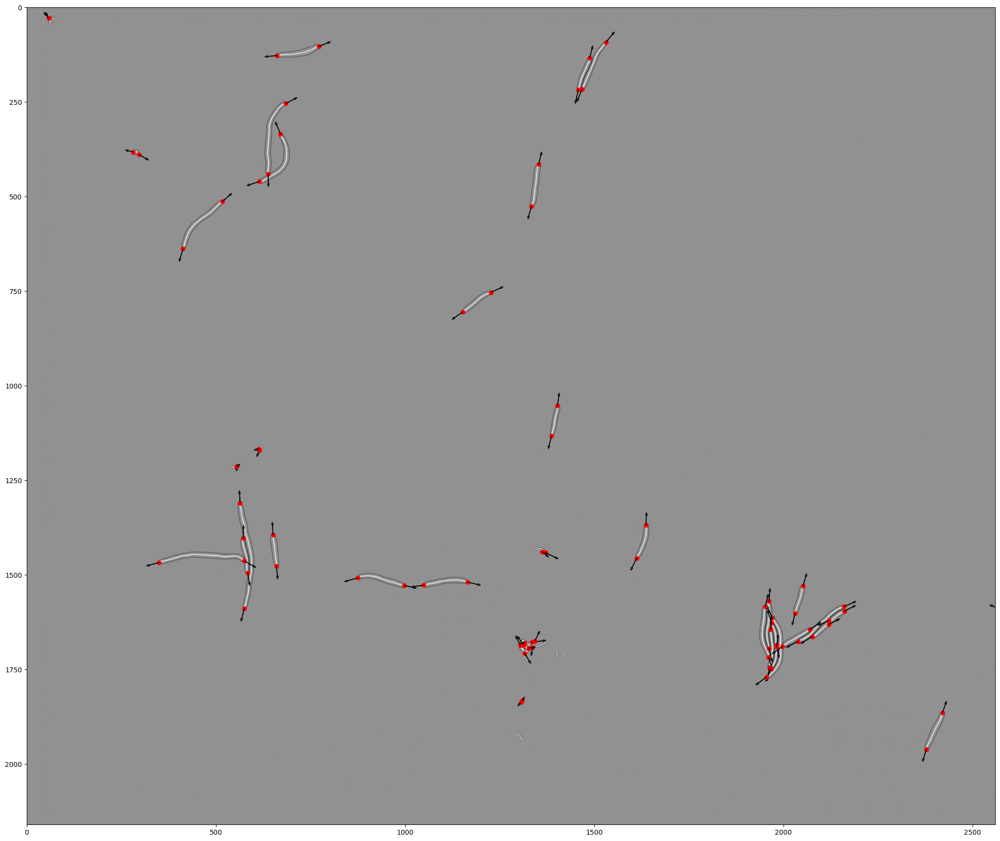

In [22]:
store_imag("/Users/sherryyang/wigginsLab/data/0709/xy0/phase/211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00001xy0c1_seg.npy")

In [7]:
work('211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00032xy0c1_seg.npy')

NameError: name 'work' is not defined

In [ ]:
result_ends = flow_to_ends(centers, gradient_total,-1)

In [56]:
centers = find_skeleton_centers(42, gradient_total, -1, regs_label)

In [129]:
all_ends = find_muti_ends(2, 42, centers, gradient_total,-1, regs_label)

In [120]:
ends = flow_to_ends(centers, gradient_total,-1)

In [6]:
import matplotlib.pyplot as plt
plt.figure(figsize=(25.63, 21.87))
image = plt.imshow(gradient_total, cmap='Greys')
for each in all_ends:
    [x,y] = extract_xy(each,DIGIT)
    plt.scatter(x, y, c='red', marker='o')
    [vx,vy] = calculate_local_slop(each, 30,gradient_total,regs_label, -1)
    plt.arrow(x, y, vx, vy, head_width = 2, width = 0.5, ec ='black')

NameError: name 'gradient_total' is not defined

<Figure size 2563x2187 with 0 Axes>

In [29]:
len(gradient_total[])

2563

array([[ 1.34829283e-02,  1.28139853e-02,  1.05031729e-02, ...,
         8.96608643e-03,  1.06038451e-02,  8.58390704e-03],
       [ 9.12971050e-03,  9.31141060e-03,  8.35260563e-03, ...,
         5.49107604e-03,  5.87427616e-03,  2.55280640e-03],
       [ 2.21307855e-04,  2.27373093e-05, -4.22447920e-04, ...,
        -1.03798509e-03, -1.59341097e-03, -3.89993191e-03],
       ...,
       [-1.13614321e-01,  1.06028924e-02,  8.42345953e-02, ...,
         1.24920905e-02,  1.86098814e-02,  3.89141217e-03],
       [-1.15279555e-01,  1.13671422e-02,  8.61322582e-02, ...,
         3.41744497e-02,  1.77878439e-02, -9.20767337e-03],
       [-1.19068623e-01,  2.00244486e-02,  8.59495997e-02, ...,
         3.83816995e-02,  6.69264793e-03, -1.01674870e-02]], dtype=float32)

In [175]:
gradientsx = np.gradient(dat['flows'][-1][0])

In [178]:
dat['flows'][-1][2]

array([[-5.3313503, -5.332156 , -5.335718 , ..., -5.3484836, -5.349257 ,
        -5.3458815],
       [-5.324917 , -5.3232355, -5.327735 , ..., -5.349199 , -5.350671 ,
        -5.3484225],
       [-5.3301315, -5.3285275, -5.3319755, ..., -5.3620415, -5.3651524,
        -5.3631134],
       ...,
       [-5.41252  , -5.318721 , -5.28403  , ..., -5.210467 , -5.347294 ,
        -5.205212 ],
       [-5.4117875, -5.3396416, -5.2886505, ..., -5.292884 , -5.3475347,
        -5.211696 ],
       [-5.4147873, -5.356273 , -5.294237 , ..., -5.2815104, -5.3507676,
        -5.2026   ]], dtype=float32)

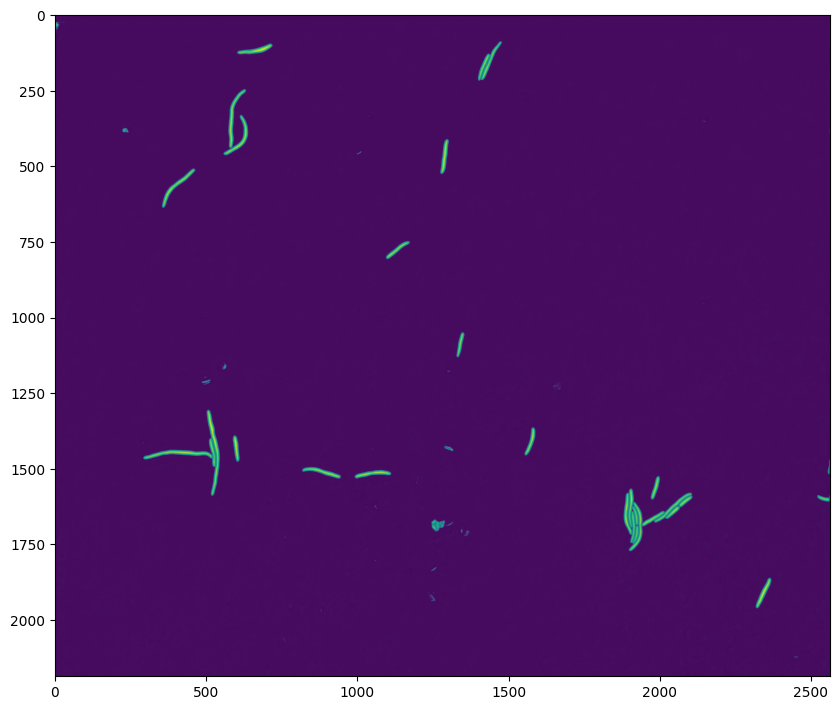

In [191]:
dat = np.load('211121_37C_10_1176_HU_timelapse002_prob211203_HU_t00001xy0c1_seg.npy', allow_pickle=True).item()
plt.figure(figsize=(10, 10))
plt.imshow(dat['flows'][-1][2])

In [197]:
dat['masks']

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

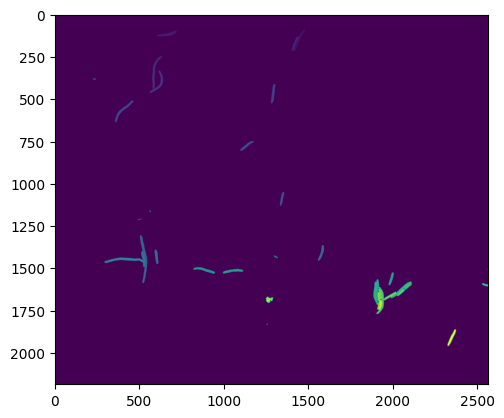

In [198]:
plt.imshow(dat['masks'])

In [199]:
regs_label = dat['masks']

In [203]:
np.max(regs_label)

42

In [205]:
result = np.empty_like(regs_label, dtype=object)

In [206]:
result

array([[None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       ...,
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None]], dtype=object)

In [209]:
result = np.empty_like(regs_label, dtype=object)
for each in all_ends:
    [x,y] = extract_xy(each,DIGIT)
    [vx,vy] = calculate_local_slop(each, 30,gradient_total,regs_label, -1)
result[y,x] = [vy,vx]

In [217]:
result[y,x]

[-11.967391304347757, 4.336956521739012]

In [215]:
result[np.where(result is None)] = np.nan

np.savetxt('result.csv', result.reshape(result.shape[0], -1), delimiter=',', fmt='%s')

In [216]:
result[-11.967391304347757, 4.336956521739012]

IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

In [237]:
result[y,x]

[-11.967391304347757, 4.336956521739012]

In [219]:
y

1865

In [220]:
x

2364

In [ ]:
pd.savetxt('result.csv', result.reshape(result.shape[0], -1), delimiter=',', fmt='%s')

In [224]:
import pandas as pd
result_pd = pd.
pd.to_csv('result.csv')

AttributeError: module 'pandas' has no attribute 'to_csv'

In [226]:
from scipy.io import savemat
result[np.where(result is None)] = 1
data = {'result': result}
savemat('result.mat', data)

ValueError: could not broadcast input array from shape (2,) into shape (0,2563)

In [231]:
result

array([[None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       ...,
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None]], dtype=object)

In [233]:
result[np.where(result is None)] 

In [234]:
tes

array([], shape=(0, 2563), dtype=object)

In [239]:
shape(tras)

NameError: name 'shape' is not defined

In [238]:
tras = np.array(result)

In [240]:
tras

array([[None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       ...,
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None],
       [None, None, None, ..., None, None, None]], dtype=object)

In [256]:
trans_array = np.zeros([len(regs_label[0]),len(regs_label),3])

In [257]:
for each in all_ends:
        [x,y] = extract_xy(each,DIGIT)
        [vx,vy] = calculate_local_slop(each, 30,gradient_total,regs_label, -1)
        two_d_array[x,y] = [vx,vy,1]

In [262]:
np.max(two_d_array[:, :, 2])

1.0

In [264]:
mask = two_d_array[:, :, 2] == 1
masked_array = two_d_array[mask]

In [265]:
masked_array

array([[ -2.69230769,  -7.34615385,   1.        ],
       [  0.30769231,  -5.34615385,   1.        ],
       [ -7.01086957,  -1.89130435,   1.        ],
       [  8.98913043,   5.10869565,   1.        ],
       [-13.37777778,   1.83333333,   1.        ],
       [ -3.96511628,  13.25581395,   1.        ],
       [  9.67073171,  -8.37804878,   1.        ],
       [ -0.28571429,   1.46428571,   1.        ],
       [  0.71428571,  -0.53571429,   1.        ],
       [ -0.79381443, -12.77319588,   1.        ],
       [  0.3655914 , -13.30107527,   1.        ],
       [ 11.78494624,   7.72043011,   1.        ],
       [ -3.4137931 ,  13.81609195,   1.        ],
       [  2.08433735,  13.46987952,   1.        ],
       [ -3.17073171,   5.46341463,   1.        ],
       [-12.75294118,   4.14117647,   1.        ],
       [ -2.17073171,   5.46341463,   1.        ],
       [  0.27083333,  13.36458333,   1.        ],
       [ -1.75257732, -13.39175258,   1.        ],
       [-12.75581395,   1.29069

In [266]:
two_d_array.to_csv("test.csv")

AttributeError: 'numpy.ndarray' object has no attribute 'to_csv'

In [268]:
data = {'two_d_array': two_d_array}
savemat('result.mat', data)

In [269]:
two_d_array

array([[[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       ...,

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]],

       [[0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.],
        ...,
        [0., 0., 0.],
        [0., 0., 0.],
        [0., 0., 0.]]])

In [279]:
len(regs_label[0])

2563

In [280]:
shape(regs_label)

NameError: name 'shape' is not defined

In [281]:
regs_label

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint16)

In [282]:
len(gradient_total)

2187

In [283]:
len(gradient_total[0])

2563